# **Project: Schelling's Model of Segregation**

## different Segregation coefficient (bm)

In [23]:
#defining the bmlist and movementlist to store the named values so we can make a graph based on them 
bmlist=[]
movementlist=[]

### bm=0.85

In [ ]:
"""
- This is a model that shows how Bigotry (Racism, Classism, ...) can shape a biased society - 
using the Schelling's Model by showing each group by a color we can see how tey choose to avoid people from the other group 
& getting further and further away from each other.
think of each color as a house of people of one idiology and white houses as the empty houses
you can see how increasing the intolerance of people toward the other group, bm (the Segregation coefficient), can lead to 
the complete separation of the two groups.
"""
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap


#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

#making the grid
L=60  #length of the grid(so the whole map is L*L)
bm=0.85  #Segregation coefficient (how intolerance are people of a kind to the other kind)

""" 
the difference between p & q shows the white(empty) houses/
the <p shows the pink houses (one ideology/belief system/...)/
the q> shows the blue houses (the other ideology/belief system/...). 
""" 
p=0.4725
q=0.5275

#creating a folder that frame images will be saved
gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 

#Initializing the grid
#making the list of the positions
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
#making a dictionary that contain keys as positions(x,y) & colors as values(0/1/2)
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    #initializing the things that we need for representation
    fig,ax=plt.subplots(figsize=(8,8))  #creating a figure & axis
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])  #removing the axis numbers
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    #making a 2D array of the color(the squaresdict's values)
    grid=np.zeros((L, L), dtype=int) #making empty grids so they can contain a color by the values of squaresdict 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val
    """ 
    this part (making the 2D array) was beautiful and I had fun coding it: 
    I took both the values and keys of the dict and work with them simulataneously i am free to do that only if i had an array
    because the keys of the dict can be the row & column of an array and the value of the dict can be an element of the matrix (array).
    even though people often say working with dictionaries is hard, this is actually a good way to handle them
    """
    
    #converting the grids with values to colors based on the cmap  that we defined earlier
    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    #saving the gif
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 #this is a threshold for the model to avoid facing infinity. the saturation will be most probably before this step
step=0
movement=0
while step<max_steps:
    step +=1
    """creating a new dict to contains a copy of the entire grid & copying the values from squaresdict
    (If a position (i, j) doesn't exist in squaresdict, it assigns the value 0."""
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):  #(x,y)
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color #compliant agent

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]
        #calculating the number of the colors of neighbors
        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        #checking waht is the color of the selected house & whatever it is the number assign tp it will be the number of that color in neighbors
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition (that '+1' helps us avoid 0 devision)
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            #if the condition is met the selected house will be empty (becuase the selected person wants to emigrate to a house filled with more people like them)
            new_squaresdict[x, y] = 0 
            movement+=1 #saving the number of movements for later graph

            """so where will the selected person go?
            it will choose a house that is empty and go there but chosen randomly. so we will choose 
            a (x,y) randomly untill it is empty by checking it's value in the new_squaresdict.
            that's why we defined the new_squaresdict, we needed a copy of each house becuse the squaresdict itself
            will be updated at each step so we needed an artificial space to check the empty houses
            """
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy()  

        # Visualize a few more steps after saturation (for better visualization purpose)
        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    #the simulation has moved forward 1 step, now we use this new state as the starting point for the next step
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step)) #visualizing the updated state of the grid for the current step

#saturation step as a pic
grid=np.zeros((L,L), dtype=int)
for (x,y), v in squaresdict.items():
    grid[x, y]=v
plt.figure(figsize=(8, 8))
plt.imshow(grid, cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.85")
plt.show()


bmlist.append(bm)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")


In [1]:
""" bm is too high there'll never be a saturation point / I have deleted the result due to the size limit of the file uploading in github"""

" bm is too high there'll never be a saturation point / I have deleted the result due to the size limit of the file uploading in github"

### bm=0.75

Simulation stopped at step 1027: system unchanged.


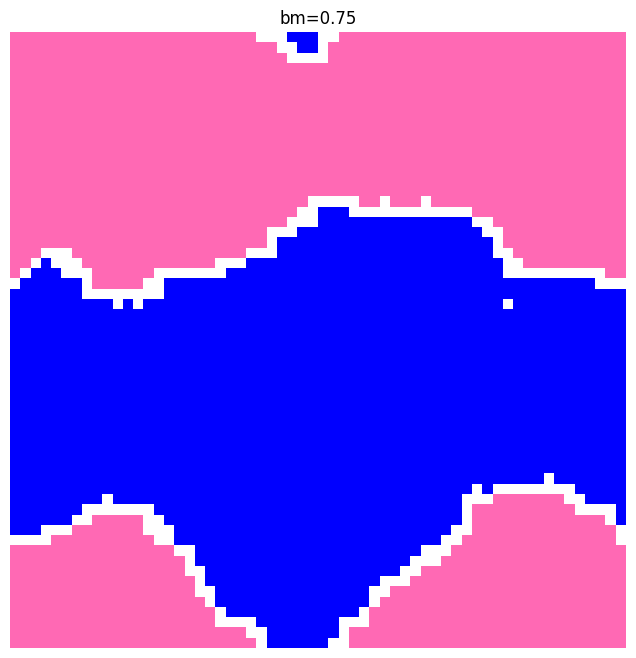

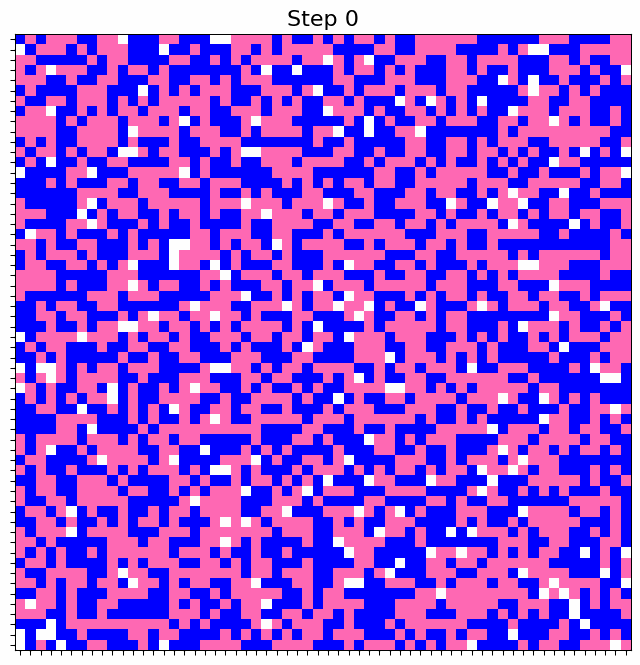

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap


cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

#making the grid
L=60 
bm=0.75

p=0.4725
q=0.5275

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 

#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8))
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int)
    for (x, y), val in squaresdict.items():
        grid[x, y] = val
    
    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):  #(x,y)
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color
        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]
        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition 
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy()  
        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step)) 

#saturation step as a pic
grid=np.zeros((L,L), dtype=int)
for (x,y), v in squaresdict.items():
    grid[x, y]=v
plt.figure(figsize=(8, 8))
plt.imshow(grid, cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.75")
plt.show()


bmlist.append(bm)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")

### bm=0.65

Simulation stopped at step 888: system unchanged.


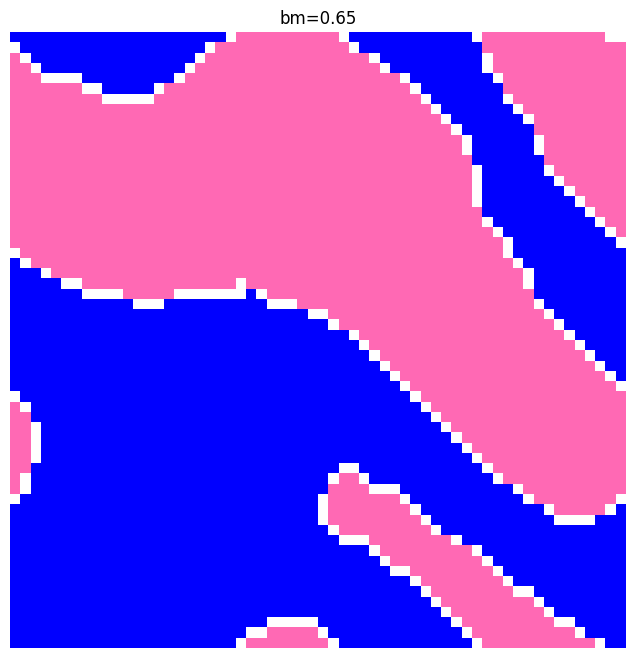

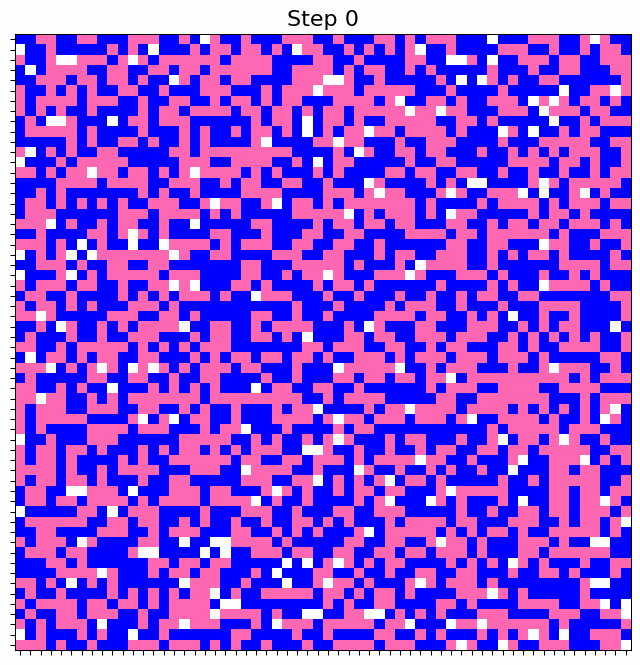

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap


cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

#making the grid
L=60 
bm=0.65

p=0.4725
q=0.5275

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 

#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8))
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int)
    for (x, y), val in squaresdict.items():
        grid[x, y] = val
    
    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):  #(x,y)
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color
        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]
        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition 
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy()  
        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step)) 

#saturation step as a pic
grid=np.zeros((L,L), dtype=int)
for (x,y), v in squaresdict.items():
    grid[x, y]=v
plt.figure(figsize=(8, 8))
plt.imshow(grid, cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.65")
plt.show()


bmlist.append(bm)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")

### bm=0.55

Simulation stopped at step 21: system unchanged.


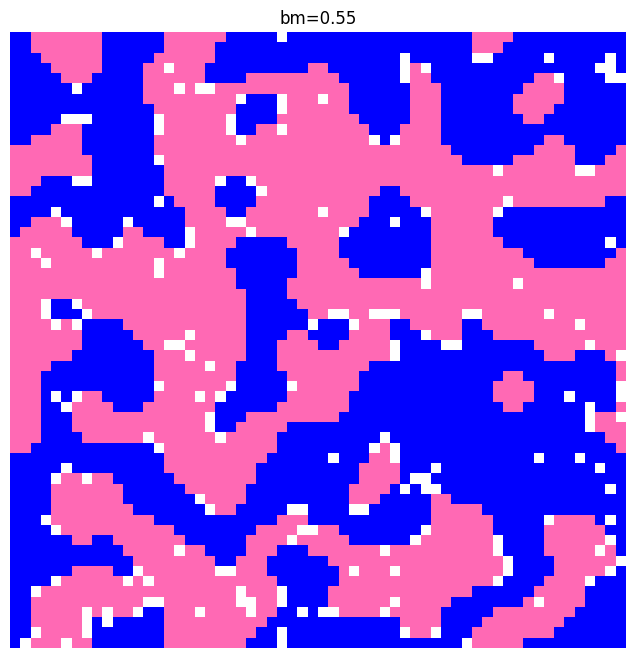

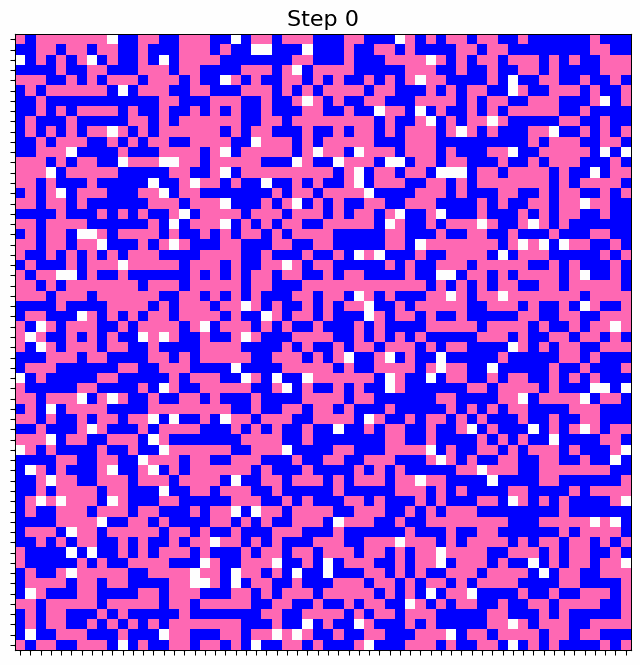

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap

#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

L=60 
bm=0.55
p=0.4725
q=0.5275

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 
#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8)) 
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int) 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val

    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]

        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")

        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step))


#saturation step as a pic
grid=np.zeros((L,L), dtype=int)
for (x,y), v in squaresdict.items():
    grid[x, y]=v
plt.figure(figsize=(8, 8))
plt.imshow(grid, cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.55")
plt.show()


bmlist.append(bm)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")


### bm=0.45

Simulation stopped at step 19: system unchanged.


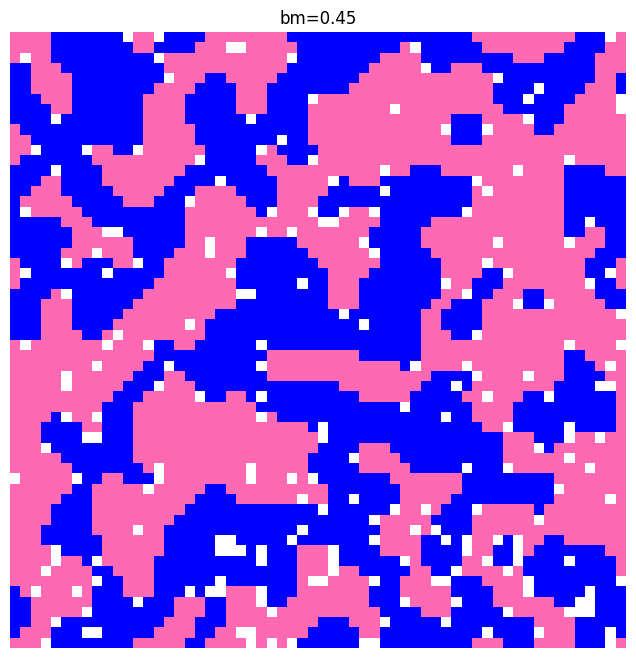

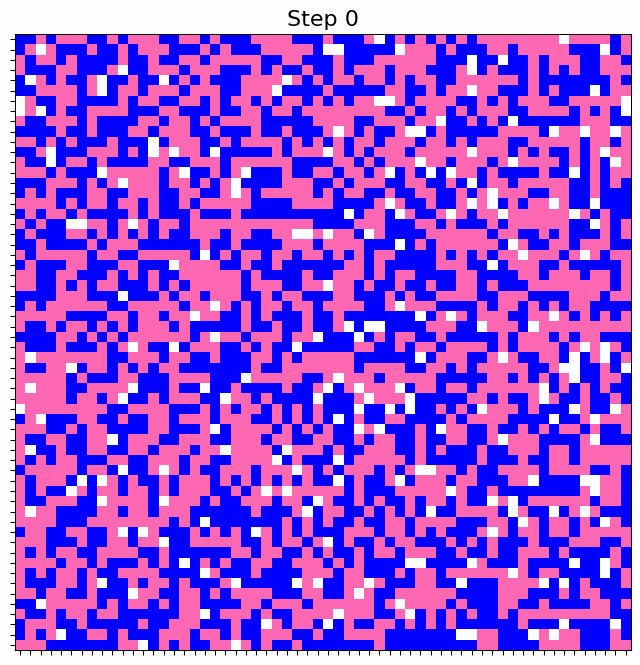

In [29]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap


cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

#making the grid
L=60 
bm=0.45

p=0.4725
q=0.5275

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 

#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8))
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int)
    for (x, y), val in squaresdict.items():
        grid[x, y] = val
    
    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):  #(x,y)
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color
        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]
        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition 
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy()  
        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step)) 

#saturation step as a pic
grid=np.zeros((L,L), dtype=int)
for (x,y), v in squaresdict.items():
    grid[x, y]=v
plt.figure(figsize=(8, 8))
plt.imshow(grid, cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.45")
plt.show()


bmlist.append(bm)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")

### Graph (Bm-Movement)

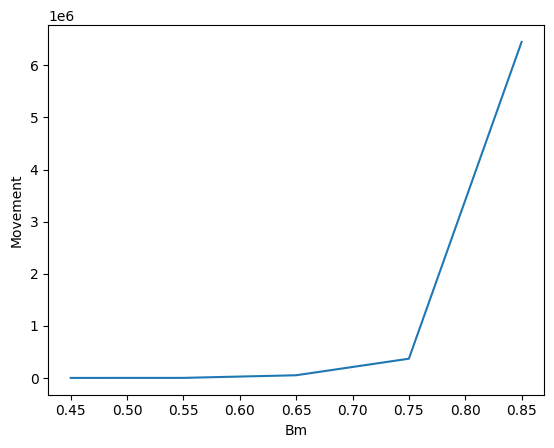

In [30]:
import numpy as np
import matplotlib.pyplot as plt
plt.plot(bmlist,movementlist)
plt.xlabel('Bm')
plt.ylabel('Movement')
plt.show()

## Different number of the empty (white) houses

In [1]:
#defining the rholist and movementlist to store the named values so we can make a graph based on them
rholist=[]
movementlist=[]

"""the probability of a block to be white = rho (so out of L*L houses we would have (rho*L*L) White houses)"""

'the probability of a block to be white = rho (so out of L*L houses we would have (rho*L*L) White houses)'

### ρ=0.0275 (~100/3600 white houses)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap

#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

L=60 
bm=0.65
p=0.48625
q=0.51375
"""out of 3600, the number of the white houses will be (p-q)*3600 = 99 ~ 100""" #~:approximatly

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 
#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8)) 
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int) 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val

    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]

        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy() 

        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step))

#Showing the saturation step as a picture
grid=np.zeros((L,L), dtype=int)
for (x, y), v in squaresdict.items():
    grid[x, y]=v

plt.figure(figsize=(8, 8))
plt.imshow(grid,cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.65 - 100/3600 white houses")
plt.show()

rholist.append(q-p)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")

In [2]:
""" it didnt reach the saturation point (the number of white houses were small no one was ever happy) / I have deleted the result due to the size limit of the file uploading in github"""

' it didnt reach the saturation point (the number of white houses were small no one was ever happy) / I have deleted the result due to the size limit of the file uploading in github'

### ρ=0.055 (~200/3600 white houses)

Simulation stopped at step 355: system unchanged.


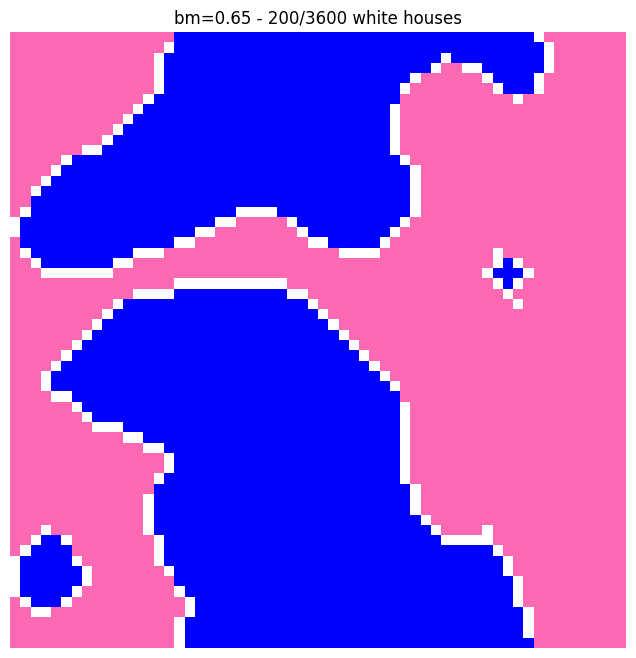

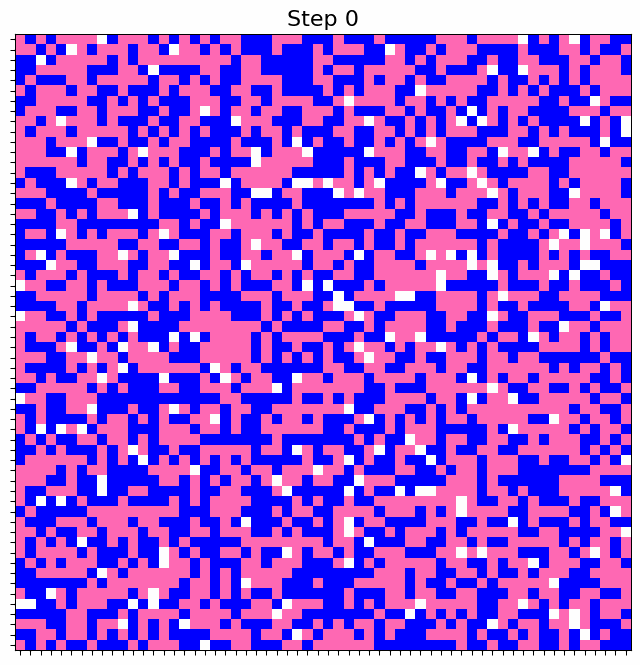

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap

#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

L=60 
bm=0.65
p=0.4725
q=0.5275
"""out of 3600, the number of the white houses will be (p-q)*3600 = 198~200"""

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 
#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8)) 
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int) 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val

    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]

        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy() 

        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step))

#Showing the saturation step as a picture
grid=np.zeros((L,L), dtype=int)
for (x, y), v in squaresdict.items():
    grid[x, y]=v

plt.figure(figsize=(8, 8))
plt.imshow(grid,cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.65 - 200/3600 white houses")
plt.show()

rholist.append(q-p)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")

### ρ=0.0825 (~300/3600 white houses)

Simulation stopped at step 141: system unchanged.


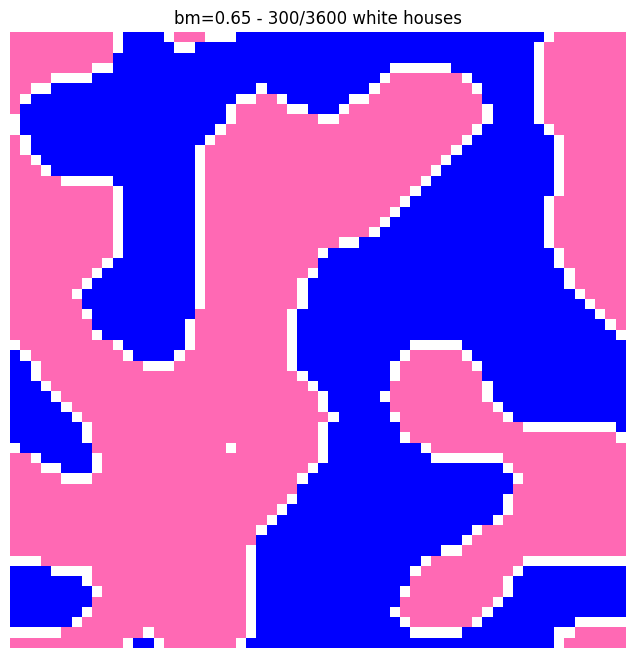

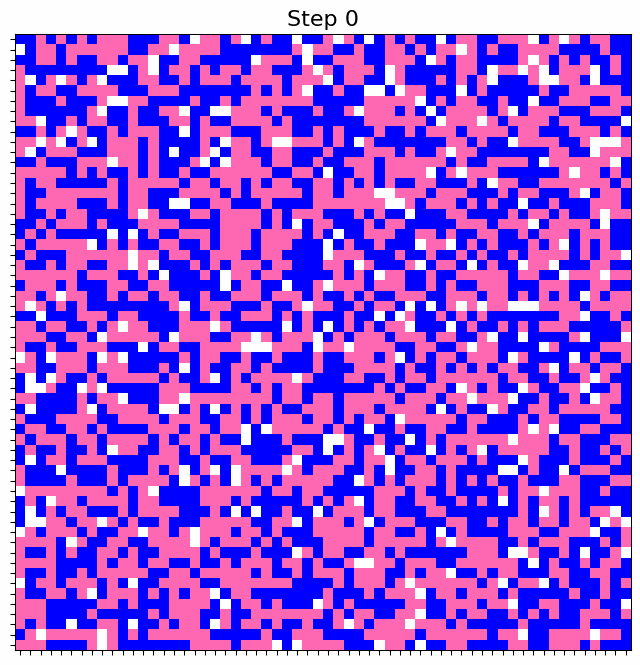

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap

#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

L=60 
bm=0.65
p=0.45875
q=0.54125
"""out of 3600, the number of the white houses will be (p-q)*3600 = 297~300"""


gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 
#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8)) 
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int) 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val

    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]

        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy() 

        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step))

#Showing the saturation step as a picture
grid=np.zeros((L,L), dtype=int)
for (x, y), v in squaresdict.items():
    grid[x, y]=v

plt.figure(figsize=(8, 8))
plt.imshow(grid,cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.65 - 300/3600 white houses")
plt.show()

rholist.append(q-p)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")

### ρ=0.11 (~400/3600 white houses)

Simulation stopped at step 86: system unchanged.


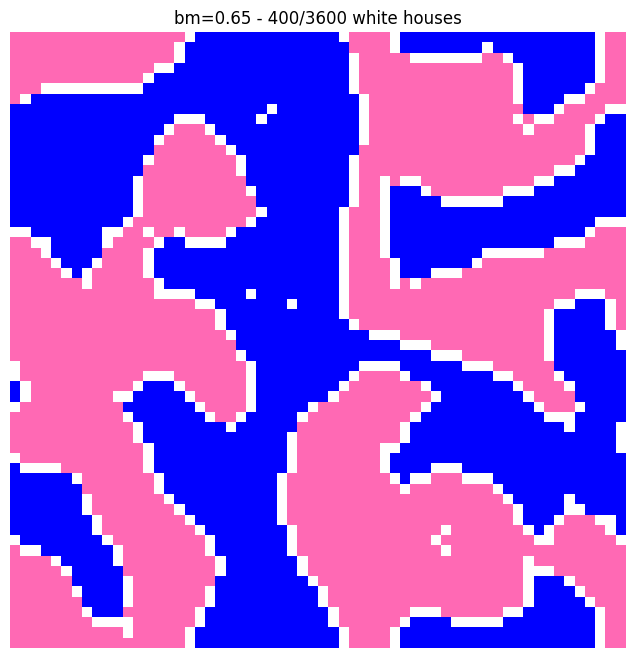

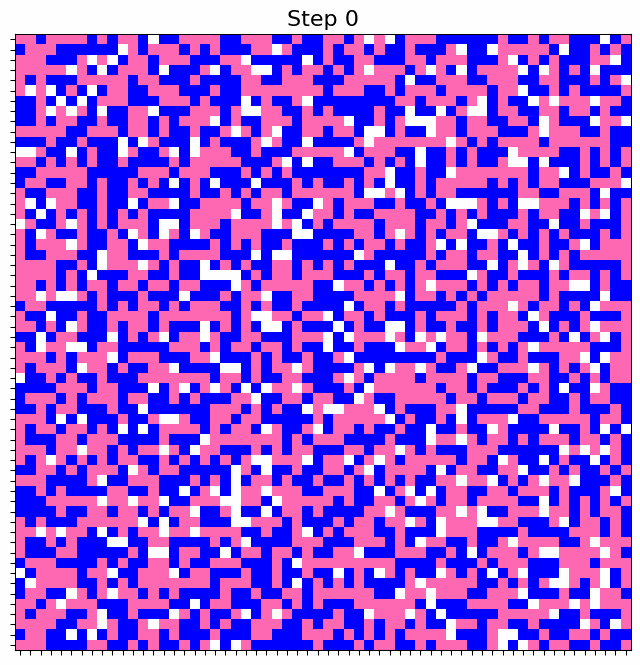

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap

#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

L=60 
bm=0.65
p=0.445
q=0.555
"""out of 3600, the number of the white houses will be (p-q)*3600 = 396 ~ 400""" #~:approximatly


gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 
#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8)) 
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int) 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val

    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]

        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy() 

        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step))

#Showing the saturation step as a picture
grid=np.zeros((L,L), dtype=int)
for (x, y), v in squaresdict.items():
    grid[x, y]=v

plt.figure(figsize=(8, 8))
plt.imshow(grid,cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.65 - 400/3600 white houses")
plt.show()

rholist.append(q-p)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")



### ρ=0.14 (~500/3600 white houses)

Simulation stopped at step 49: system unchanged.


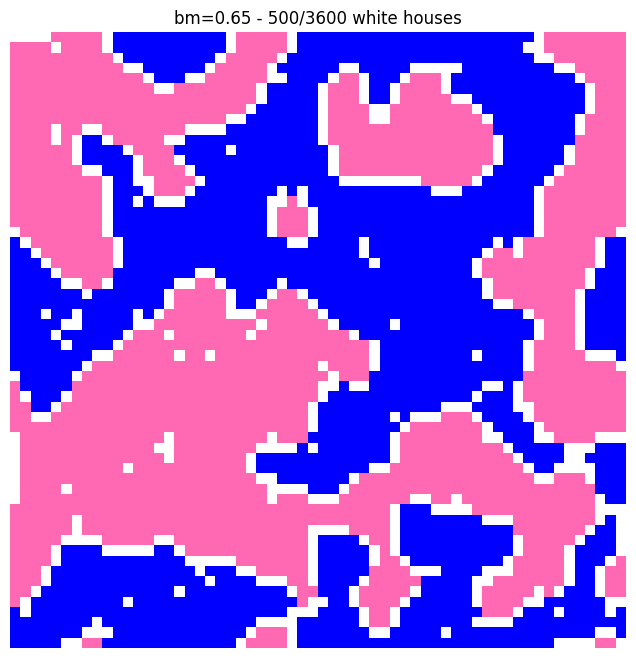

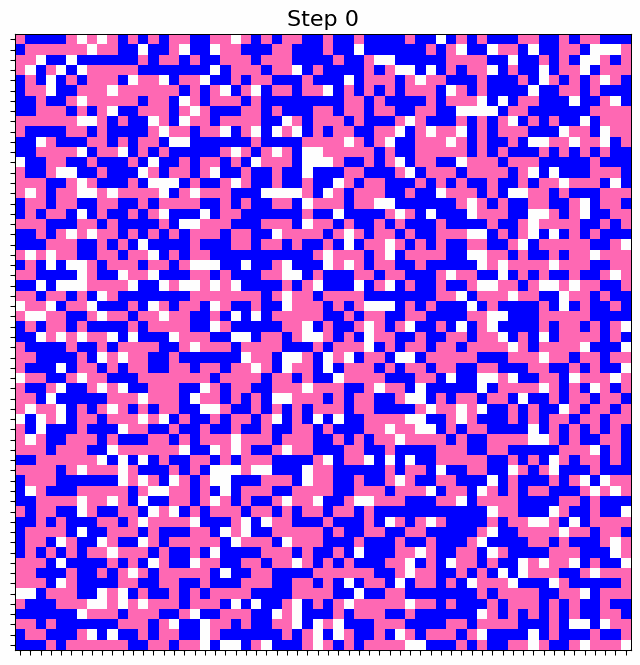

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import os
from matplotlib.colors import ListedColormap

#colormap of the houses
cmap=ListedColormap(["white","blue","hotpink"])  # 0/1/2

L=60 
bm=0.65
p=0.43
q=0.57
"""out of 3600, the number of the white houses will be (p-q)*3600 = 504 ~ 500"""

gif_frames_dir="frames"
os.makedirs(gif_frames_dir,exist_ok=True) 
#Initializing the grid
positions =[]
for i in range(L):
    for j in range(L):
        positions.append((i, j))
squaresdict = {}
random_values = np.random.rand(L * L)
for i in range(len(positions)):
    (x,y)=positions[i]
    gridnumber=random_values[i]
    if gridnumber<= p:      #pink
        squaresdict[x,y]=2
    elif p<gridnumber<q:    #white
        squaresdict[x,y]=0
    else:                   #blue
        squaresdict[x,y]=1

#showing the squares with imshow
def plot_grid_imshow(squaresdict,step):
    fig,ax=plt.subplots(figsize=(8,8)) 
    ax.set_aspect('equal')
    ax.set_xticks(np.arange(0,L+1))
    ax.set_yticks(np.arange(0,L+1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(f"Step {step}",fontsize=16)

    grid=np.zeros((L, L), dtype=int) 
    for (x, y), val in squaresdict.items():
        grid[x, y] = val

    ax.imshow(grid,cmap=cmap,vmin=0,vmax=2)
    frame_path = f"{gif_frames_dir}/frame_{step:02d}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    plt.close()
    return frame_path
frame_paths= [plot_grid_imshow(squaresdict, 0)]

max_steps= 2000 
step=0
movement=0
while step<max_steps:
    step +=1
    new_squaresdict={key: squaresdict.get(key, 0) for key in [(i, j) for i in range(L) for j in range(L)]}
    
    for (x, y), color in list(squaresdict.items()):
        if color==0:
            continue

        neighborsvalues=[]
        compliant=color

        #making neighbors of a selected house (8 neighbors)
        neighbors=[((x+1)%L, y), ((x-1)%L, y), (x, (y+1)%L), (x, (y-1)%L),((x-1)%L,(y-1)%L),((x+1)%L,(y+1)%L),((x-1)%L, (y+1)%L), ((x+1)%L, (y-1)%L)]
        neighborsvalues=[squaresdict.get(n, 0) for n in neighbors]

        count_1=neighborsvalues.count(1)  # blue
        count_2=neighborsvalues.count(2)  # pink
        if compliant==1:
            compliantcolor=count_1
        else:
            compliantcolor=count_2

        #Schelling's condition
        if (compliantcolor+1)/(count_1+count_2+1)<=bm:
            new_squaresdict[x, y] = 0 
            movement+=1
            x_rand =np.random.randint(L)
            y_rand=np.random.randint(L)
            while new_squaresdict[(x_rand, y_rand)] != 0:
                x_rand=np.random.randint(L)
                y_rand= np.random.randint(L)
            new_squaresdict[(x_rand, y_rand)] = compliant

    # saturation detection (system unchanged)
    if new_squaresdict==squaresdict:
        print(f"Simulation stopped at step {step}: system unchanged.")
        squaresdict = new_squaresdict.copy() 

        for i in range(10):
            step+=1
            frame_paths.append(plot_grid_imshow(squaresdict, step))
        break  
    squaresdict=new_squaresdict.copy()
    frame_paths.append(plot_grid_imshow(squaresdict, step))

#Showing the saturation step as a picture
grid=np.zeros((L,L), dtype=int)
for (x, y), v in squaresdict.items():
    grid[x, y]=v

plt.figure(figsize=(8, 8))
plt.imshow(grid,cmap=cmap, vmin=0, vmax=2)
plt.axis('off')
plt.title("bm=0.65 - 500/3600 white houses")
plt.show()

rholist.append(q-p)
movementlist.append(movement)

#Creating GIF
gif_path="schelling_simulation_fast.gif"
with imageio.get_writer(gif_path,mode='I', duration=2.0, loop=0) as writer:
    for frame_path in frame_paths:
        image = imageio.imread(frame_path)
        writer.append_data(image)
from IPython.display import Image
Image(filename="schelling_simulation_fast.gif")


### Graph (Movement-ρ)

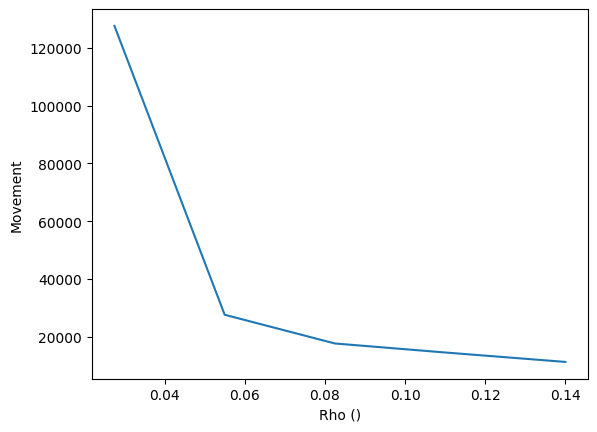

In [7]:
import numpy as np
import matplotlib.pyplot as plt
plt.plot(rholist,movementlist)
plt.xlabel('Rho ()')
plt.ylabel('Movement')
plt.show()